Modified and translated code from [this source](https://www.kaggle.com/code/s4dead/crimes-in-boston-visualization/notebook).  Added the ability to get summary statistics for a path.

## Imports

In [1]:
import datetime

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium import plugins
import plotly.express as px

from sklearn.neighbors import KNeighborsClassifier


import alphashape

%matplotlib inline
sns.set()

#from openrouteservice import client, places

import polyline
from shapely.geometry import Polygon, LineString, Point
import geopandas



## Config variables

In [2]:
MAXYEAR = 2025
MINYEAR = 2013

## Data Import

In [3]:
from datetime import datetime

date_parser = lambda x: pd.to_datetime(x, format="%Y-%m-%d %H:%M:%S", errors="coerce")

data = pd.read_csv('data/crimesBoston.csv', encoding='latin-1',
                   parse_dates=['OCCURRED_ON_DATE'], date_parser=date_parser,dtype={'INCIDENT_NUMBER': 'str'})

/tmp/ipykernel_16172/3049457010.py:5: FutureWarning: The argument 'date_parser' is deprecated and will be removed in a future version. Please use 'date_format' instead, or read your data in as 'object' dtype and then call 'to_datetime'.
  data = pd.read_csv('data/crimesBoston.csv', encoding='latin-1',
/tmp/ipykernel_16172/3049457010.py:5: DtypeWarning: Columns (2,6,12) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('data/crimesBoston.csv', encoding='latin-1',


In [4]:
print(data.info())  # Check types to confirm parsing


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 809459 entries, 0 to 809458
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   INCIDENT_NUMBER      809459 non-null  object        
 1   OFFENSE_CODE         809459 non-null  int64         
 2   OFFENSE_CODE_GROUP   353253 non-null  object        
 3   OFFENSE_DESCRIPTION  809459 non-null  object        
 4   DISTRICT             804793 non-null  object        
 5   REPORTING_AREA       779158 non-null  object        
 6   SHOOTING             457661 non-null  object        
 7   OCCURRED_ON_DATE     656904 non-null  datetime64[ns]
 8   YEAR                 809459 non-null  int64         
 9   MONTH                809459 non-null  int64         
 10  DAY_OF_WEEK          809459 non-null  object        
 11  HOUR                 809459 non-null  int64         
 12  UCR_PART             353156 non-null  object        
 13  STREET        

In [5]:
data.head(5)

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location,OFFENSE_CODE_NAME
0,212012996,1102,NaN,FRAUD - FALSE PRETENSE / SCHEME,B2,259,0,2020-01-01,2020,1,Wednesday,0,NaN,ALEXANDER ST,42.316942,-71.069912,"(42.3169424347871, -71.0699121273113)",FRAUD - FALSE PRETENSE
1,212008096,1107,NaN,FRAUD - IMPERSONATION,A1,118,0,2020-01-01,2020,1,Wednesday,0,NaN,BOYLSTON ST,42.352418,-71.065255,"(42.3524181472861, -71.0652549858121)",FRAUD - LARCENY BY SCHEME
2,202000034,3006,NaN,SICK/INJURED/MEDICAL - PERSON,C6,201,0,2020-01-01,2020,1,Wednesday,0,NaN,W BROADWAY,42.340070,-71.052794,"(42.340069862647, -71.0527942008028)",SICK/INJURED/MEDICAL - PERSON
3,202007210,1001,NaN,FORGERY / COUNTERFEITING,C6,200,0,2020-01-01,2020,1,Wednesday,0,NaN,ORTON-MAROTTA WAY,42.341288,-71.054679,"(42.3412875043904, -71.054679326494)",COUNTERFEITING
4,202000355,617,NaN,LARCENY THEFT FROM BUILDING,A1,77,0,2020-01-01,2020,1,Wednesday,0,NaN,FRIEND ST,42.361839,-71.059765,"(42.3618385665647, -71.0597648909416)",LARCENY IN A BUILDING $200 & OVER


## Summary Statistics

In [6]:
data.isna().sum()

INCIDENT_NUMBER             0
OFFENSE_CODE                0
OFFENSE_CODE_GROUP     456206
OFFENSE_DESCRIPTION         0
DISTRICT                 4666
REPORTING_AREA          30301
SHOOTING               351798
OCCURRED_ON_DATE       152555
YEAR                        0
MONTH                       0
DAY_OF_WEEK                 0
HOUR                        0
UCR_PART               456303
STREET                  11888
Lat                     45178
Long                    45178
Location                45178
OFFENSE_CODE_NAME           0
dtype: int64

In [7]:
data.describe()

,OFFENSE_CODE,OCCURRED_ON_DATE,YEAR,MONTH,HOUR,Lat,Long
count,809459.000000,656904,809459.000000,809459.000000,809459.000000,7.642810e+05,7.642810e+05
mean,2336.648466,2018-12-12 11:55:38.133420800,2019.378620,6.734334,12.891114,4.232255e+01,-7.108328e+01
min,100.000000,2015-06-15 00:00:00,2015.000000,1.000000,0.000000,1.327276e-07,-7.134947e+01
25%,1102.000000,2017-02-13 20:51:00,2017.000000,4.000000,9.000000,4.229755e+01,-7.109823e+01
50%,3005.000000,2018-09-27 16:01:30,2019.000000,7.000000,14.000000,4.232708e+01,-7.107763e+01
75%,3201.000000,2020-09-28 18:05:00,2022.000000,10.000000,18.000000,4.234874e+01,-7.106178e+01
max,99999.000000,2022-12-31 23:50:00,2024.000000,12.000000,23.000000,4.246141e+01,5.249691e-08
std,1191.929022,NaN,2.784351,3.349824,6.399714,5.810940e-02,8.687170e-02


### Number of unique values ​​in columns


In [8]:
for column in data:
    print(f'{column}: {data[column].unique().size}')

INCIDENT_NUMBER: 767386
OFFENSE_CODE: 254
OFFENSE_CODE_GROUP: 68
OFFENSE_DESCRIPTION: 305
DISTRICT: 15
REPORTING_AREA: 884
SHOOTING: 6
OCCURRED_ON_DATE: 503481
YEAR: 10
MONTH: 12
DAY_OF_WEEK: 13
HOUR: 24
UCR_PART: 5
STREET: 24683
Lat: 72541
Long: 71919
Location: 73424
OFFENSE_CODE_NAME: 184


### The unique values ​​themselves


In [9]:
for column in ['DISTRICT', 'SHOOTING', 'YEAR', 'UCR_PART']:
    print(f'{column}: {data[column].unique()}')

DISTRICT: ['B2' 'A1' 'C6' 'C11' 'D4' 'E13' 'B3' 'A7' 'E18' 'A15' 'E5' 'D14' nan
 'External' 'Outside of']
SHOOTING: [0 1 '0' '1' nan 'Y']
YEAR: [2020 2023 2024 2022 2016 2017 2021 2018 2015 2019]
UCR_PART: [nan 'Part Two' 'Part One' 'Part Three' 'Other']


## Data cleansing/transformation


Remove unnecessary columns

In [10]:

data.drop(['INCIDENT_NUMBER', 'Location'], axis=1, inplace=True)

For convenience, let's rename some columns

In [11]:
rename = {'OFFENSE_CODE_GROUP': 'Group',
          'DISTRICT': 'District',
          'REPORTING_AREA': 'Area',
          'SHOOTING': 'If_shooting',
          'OCCURRED_ON_DATE': 'Date',
          'YEAR': 'Year',
          'MONTH': 'YMonth',
          'DAY_OF_WEEK': 'WDay',
          'HOUR': 'DHour',
          'UCR_PART': 'UCR_part',
          'STREET': 'Street',
          'Long': 'Lon'}

data.rename(index=str, columns=rename, inplace=True)

Organize the days of the week

In [12]:
data.WDay = pd.Categorical(data.WDay,
                           categories=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
                           ordered=True)

We bring all unknown values ​​to a single form

In [ ]:
data.Lat.replace(-1, None, inplace=True)
data.Lon.replace(-1, None, inplace=True)

Add new columns

In [14]:
data['YDay'] = data['Date'].dt.dayofyear
data['Mday'] = data['Date'].dt.day

Let's check that everything worked out

In [15]:
data.head(5)

,OFFENSE_CODE,Group,OFFENSE_DESCRIPTION,District,Area,If_shooting,Date,Year,YMonth,WDay,DHour,UCR_part,Street,Lat,Lon,OFFENSE_CODE_NAME,YDay,Mday
0,1102,NaN,FRAUD - FALSE PRETENSE / SCHEME,B2,259,0,2020-01-01,2020,1,Wednesday,0,NaN,ALEXANDER ST,42.316942,-71.069912,FRAUD - FALSE PRETENSE,1.0,1.0
1,1107,NaN,FRAUD - IMPERSONATION,A1,118,0,2020-01-01,2020,1,Wednesday,0,NaN,BOYLSTON ST,42.352418,-71.065255,FRAUD - LARCENY BY SCHEME,1.0,1.0
2,3006,NaN,SICK/INJURED/MEDICAL - PERSON,C6,201,0,2020-01-01,2020,1,Wednesday,0,NaN,W BROADWAY,42.340070,-71.052794,SICK/INJURED/MEDICAL - PERSON,1.0,1.0
3,1001,NaN,FORGERY / COUNTERFEITING,C6,200,0,2020-01-01,2020,1,Wednesday,0,NaN,ORTON-MAROTTA WAY,42.341288,-71.054679,COUNTERFEITING,1.0,1.0
4,617,NaN,LARCENY THEFT FROM BUILDING,A1,77,0,2020-01-01,2020,1,Wednesday,0,NaN,FRIEND ST,42.361839,-71.059765,LARCENY IN A BUILDING $200 & OVER,1.0,1.0


In [16]:
data.columns

Index(['OFFENSE_CODE', 'Group', 'OFFENSE_DESCRIPTION', 'District', 'Area',
       'If_shooting', 'Date', 'Year', 'YMonth', 'WDay', 'DHour', 'UCR_part',
       'Street', 'Lat', 'Lon', 'OFFENSE_CODE_NAME', 'YDay', 'Mday'],
      dtype='object')

## Map Visualization

### Finding county boundaries

Delete knowingly incomplete/inaccurate data

In [17]:
data_counties = data[['District', 'Lat', 'Lon']].dropna()
data_counties['Lat'] = pd.to_numeric(data_counties['Lat'])
data_counties['Lon'] = pd.to_numeric(data_counties['Lon'])

Getting rid of outliers using the nearest neighbor method

In [18]:
neigh = KNeighborsClassifier(n_neighbors=500, n_jobs=-1)
neigh.fit(data_counties[['Lat', 'Lon']], data_counties['District'])

KNeighborsClassifier(n_jobs=-1, n_neighbors=500)

Assigning new county numbers

In [19]:
data_counties['District'] = neigh.predict(data_counties[['Lat', 'Lon']])

Get bounds for new labels

In [ ]:
district_groups = data_counties.groupby(['District'])
geojson = {'type': 'FeatureCollection'}
geojson['features'] = []
# Multipolygons are being generated will keep maximal shape as district boundary
counter = 0
for district, data_district in dict(list(district_groups)).items():
    pointOutline = alphashape.alphashape(data_district[['Lon', 'Lat']].values,
                                           alpha=np.sqrt(data_district.shape[0]) * 1.5)
    hullGeom = {}
    if pointOutline.geom_type == 'MultiPolygon':
        maxSize = 0
        for geom in pointOutline.geoms:
            x,y = geom.exterior.xy
            geomSize = len(x)
            if geomSize > maxSize:
                maxSize = geomSize
                hullGeom = geom.exterior.coords
    else:
        hullGeom = pointOutline.exterior.coords

    hull_curr = list(hullGeom)
    geojson['features'].append({'type': 'Feature',
                                'geometry': {
                                    'type': 'Polygon',
                                    'coordinates': [hull_curr]
                                },
                                'properties': {'district': district}})
    counter = counter + 1

Let's look at the resulting boundaries

In [21]:
fig = px.choropleth_mapbox(data_counties, geojson=geojson, color='District',
                           locations='District', featureidkey='properties.district',
                           center={'lat': 42.315, 'lon': -71.1},
                           mapbox_style='carto-positron', zoom=10.5,
                           opacity=0.5)
fig.update_layout(margin={'r': 0, 't': 0, 'l': 0, 'b': 0})
fig.show()

#### Distribution of crimes by groups for different partitions

In [22]:
# Drawing histograms
def bar_chart(x_vals, y_vals, title=None, x_label=None, y_label=None, if_plot_vals=False):
    n = len(x_vals)
    x_pos = np.arange(n)

    plt.figure(figsize=(12, 8))
    plt.bar(x_pos, y_vals, align='center', alpha=0.6)
    plt.xticks(x_pos, x_vals)
    if title:
        plt.title(title)
    if x_label:
        plt.xlabel(x_label)
    if y_label:
        plt.ylabel(y_label)

    if if_plot_vals:
        for pos, val in zip(x_pos, y_vals):
            plt.text(pos, val, val, ha='center')

    plt.show()

Distribution of the number of all crimes by years (ignore 2022 as the year is not done)

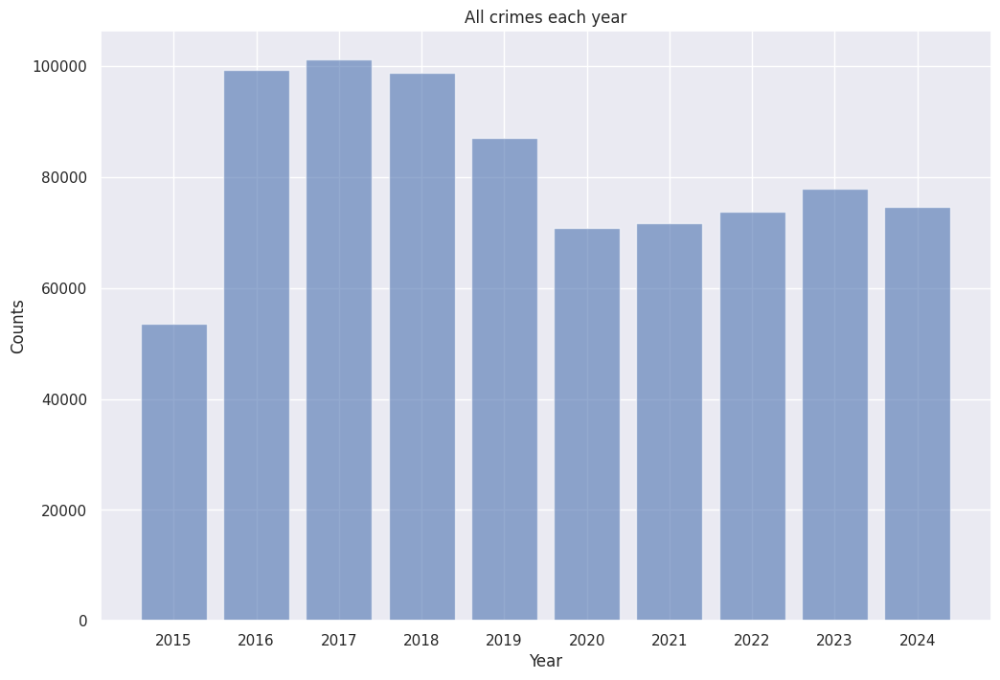

In [23]:
data_year = data.groupby(['Year']).size().reset_index(name='Counts')

bar_chart(data_year.Year, data_year.Counts, 'All crimes each year', 'Year', 'Counts')

## We now look at summary stats for specific years

In [24]:
def getDataForSpecificYear(dataFrame,year):
    assert year >= MINYEAR and year <= MAXYEAR,"invalid year value"
    return dataFrame[dataFrame['Year'] == year]

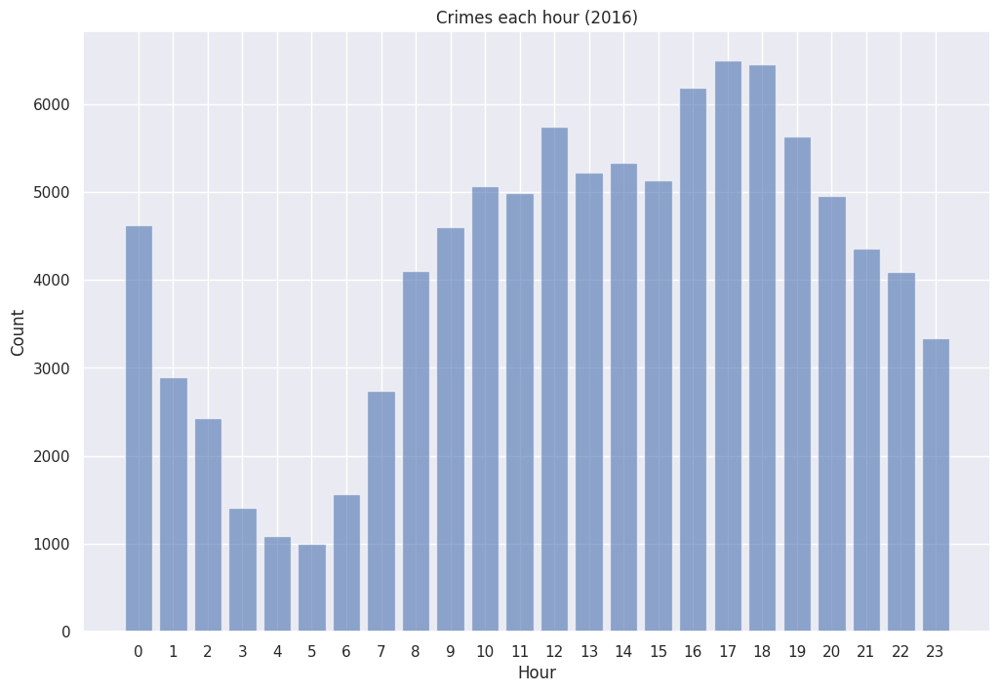

In [25]:
yearVal = 2016
single_year_data = getDataForSpecificYear(data,yearVal)
data_hour = single_year_data.groupby(['DHour']).size().reset_index(name='Counts')

bar_chart(data_hour.DHour, data_hour.Counts, 'Crimes each hour (' + str(yearVal) +')', 'Hour', 'Count')

By county


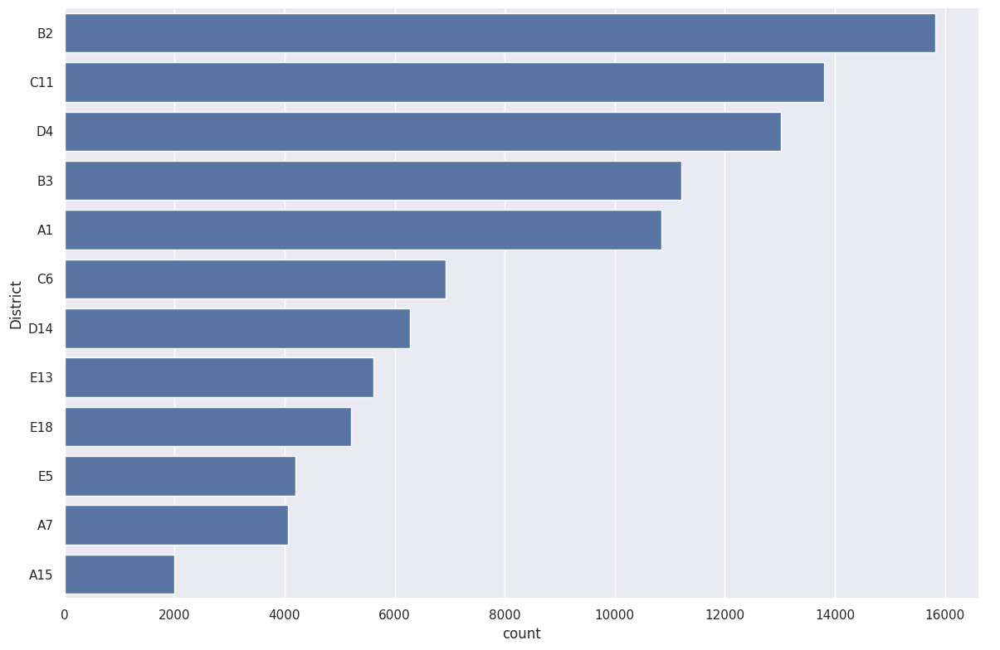

In [26]:
sns.catplot(y='District',
            kind='count',
            height=8,
            aspect=1.5,
            order=single_year_data.District.value_counts().index,
            data=single_year_data)

## Map Visualizations

Sample crimes and view coordinate and district crime map

In [29]:

map_crimes = folium.Map(location=[42.315, -71.1], zoom_start=12)
data_sample = single_year_data[['District', 'Lat', 'Lon']].dropna().sample(10000)
map_dict = {'A1': 'red', 'C11': 'blue', 'E13': 'green', 'B2': 'gray',
            'D14': 'purple', 'C6': 'pink', 'A7': 'cadetblue', 'E5': 'orange',
            'D4': 'darkred', 'B3': 'lightgreen', 'E18': 'darkblue', 'A15': 'darkgreen'}
data_sample.District = data_sample.District.map(map_dict)
for lat, long, target in zip(data_sample.Lat, data_sample.Lon, data_sample.District):
    folium.Circle((lat, long),
                   radius=5,
                   color=target,
                   fill_color='#3186cc').add_to(map_crimes)
map_crimes

View crime count by district

In [30]:
data_county = data.groupby(['District']).size().reset_index(name='Counts')

fig = px.choropleth_mapbox(data_county, geojson=geojson, color='Counts',
                           locations='District', featureidkey='properties.district',
                           color_continuous_scale="Viridis", range_color=(0, data_county['Counts'].max()),
                           center={'lat': 42.315, 'lon': -71.1},
                           mapbox_style="carto-positron", zoom=10.5,
                           opacity=0.5, labels={'Area': 'Crimes number'})
fig.update_layout(margin={'r': 0, 't': 0, 'l': 0, 'b': 0})
fig.show()

## Violent Crimes

Now we focus on violent crimes such as homicide, assault, battery.  We take as our key words from the wikipedia description:

[Depending on the jurisdiction, violent crimes may include: homicide, murder, assault, manslaughter, sexual assault, rape, robbery, negligence, endangerment, kidnapping (abduction), extortion, and harassment.](https://en.wikipedia.org/wiki/Violent_crime#Violent_crime_by_country)

However we will ignore 'negligence', and 'endangerment'.

In [37]:

def joinDataFrames(dataFrameArray):
    areEqual = all([len(dataFrameArray[0].columns.intersection(df.columns)) 
      == dataFrameArray[0].shape[1] for df in dataFrameArray])
    assert areEqual, "can not join data frames with different columns"
    result = pd.concat(dataFrameArray)
    result = result.drop_duplicates()
    return result

def selectDataFramesByKeyWord(dataFrame ,keyWord, columsToQuery=['Group','OFFENSE_DESCRIPTION','OFFENSE_CODE_NAME'],lowerStrings=True):
    # df = df[df['Credit-Rating'].str.contains('Fair')]
    dataFrameArray = []
    if lowerStrings:
        for columnName in columsToQuery:
            dataWithValues = dataFrame[dataFrame[columnName].notna()]
            print(keyWord,columnName)
            dataWithValues[columnName] = dataWithValues[columnName].apply(str.lower)
            queryWord = keyWord.lower()
            filteredDF = dataWithValues[dataWithValues[columnName].str.contains(queryWord)]
            dataFrameArray.append(filteredDF)
    else:
        for columnName in columsToQuery:
            dataWithValues = dataFrame[dataFrame[columnName].notna()]
            dataWithValues[columnName] = dataWithValues[columnName].apply(str.lower)
            queryWord = keyWord
            filteredDF = dataWithValues[dataWithValues[columnName].str.contains(queryWord)]
            dataFrameArray.append(filteredDF)
    return joinDataFrames(dataFrameArray)

In [ ]:
violentCrimeKeyWords = ['Aggravated assault','Homicide', 'HOME INVASION', 
'Manslaughter', 'HUMAN TRAFFICKING', 'BODILY HARM', 'MURDER ', 'BATTERY', 
'Kidnapping', 'ROBBERY ATTEMPT - OTHER WEAPON', 'ROBBERY - STREET', 'ROBBERY - HOME INVASION', 
'ROBBERY - CAR JACKING', 'ROBBERY - KNIFE']

homicideKeyWords = ['Homicide','Manslaughter','MURDER ']

dataWithLocations = data[data['Lat'].notna() & data['Lon'].notna()]
violentCrimesDFs = [selectDataFramesByKeyWord(dataWithLocations,keyWordVal) for keyWordVal in violentCrimeKeyWords]
homicideCrimesDFs =[selectDataFramesByKeyWord(dataWithLocations,keyWordVal) for keyWordVal in homicideKeyWords]
violentCrimeDF = joinDataFrames(violentCrimesDFs)
homicideCrimeDF = joinDataFrames(homicideCrimesDFs)
len(violentCrimeDF.index) , len(homicideCrimeDF.index)

In [39]:
violent_data_county = violentCrimeDF.groupby(['District']).size().reset_index(name='Counts')

fig = px.choropleth_mapbox(violent_data_county, geojson=geojson, color='Counts',
                           locations='District', featureidkey='properties.district',
                           color_continuous_scale="Viridis", range_color=(0, violent_data_county['Counts'].max()),
                           center={'lat': 42.315, 'lon': -71.1},
                           mapbox_style="carto-positron", zoom=10.5,
                           opacity=0.5, labels={'Area': 'Crimes number'})
fig.update_layout(margin={'r': 0, 't': 0, 'l': 0, 'b': 0})
fig.show()

In [40]:
map_crimes = folium.Map(location=[42.315, -71.1], zoom_start=12)
data_sample = homicideCrimeDF[['District', 'Lat', 'Lon']]
map_dict = {'A1': 'red', 'C11': 'blue', 'E13': 'green', 'B2': 'gray',
            'D14': 'purple', 'C6': 'pink', 'A7': 'cadetblue', 'E5': 'orange',
            'D4': 'darkred', 'B3': 'lightgreen', 'E18': 'darkblue', 'A15': 'darkgreen'}
data_sample.District = data_sample.District.map(map_dict)
for lat, long, target in zip(data_sample.Lat, data_sample.Lon, data_sample.District):
    folium.Circle((lat, long),
                   radius=2,
                   color=target,
                   fill_color='#3186cc').add_to(map_crimes)
map_crimes

/tmp/ipykernel_16172/3082774826.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



homicide counts by district

In [41]:
homicide_data_county = homicideCrimeDF.groupby(['District']).size().reset_index(name='Counts')

fig = px.choropleth_mapbox(homicide_data_county, geojson=geojson, color='Counts',
                           locations='District', featureidkey='properties.district',
                           color_continuous_scale="Viridis", range_color=(0, homicide_data_county['Counts'].max()),
                           center={'lat': 42.315, 'lon': -71.1},
                           mapbox_style="carto-positron", zoom=10.5,
                           opacity=0.5, labels={'Area': 'Crimes number'})
fig.update_layout(margin={'r': 0, 't': 0, 'l': 0, 'b': 0})
fig.show()


## Crimes on a Path

Here we look at specific paths and count how much crime has historically occured on the walking path.

We will look at walking from park street to government center and examine the crime roughly one minute walking distance away from the path.

In [47]:
import requests
import polyline

# OSRM API
url = "http://router.project-osrm.org/route/v1/foot/"
end_coords = "-71.0626,42.3563"  # Park Street Station (lon, lat)
start_coords = "-71.0581,42.3591"    # Government Center (lon, lat)

# Fetch route data
request_url = f"{url}{start_coords};{end_coords}?overview=full&geometries=geojson"
response = requests.get(request_url)
data = response.json()

# Extract route geometry
geojson_coords = data['routes'][0]['geometry']['coordinates']  # List of [lon, lat]

# Reverse to match [lat, lon] (Google Polyline format)
lat_lon_coords = [[lat, lon] for lon, lat in geojson_coords]

# Encode the coordinates to Google's polyline format
encoded_polyline = polyline.encode(lat_lon_coords)

print("Encoded Polyline:", encoded_polyline)

Encoded Polyline: cfpaGrpupLQpAAFS|@I`@CLIR?BK`@?B?B?B@B?B?D@B?B@B@B@B@@BB@BB@@@BBD?B@B@D@F?JBH@HBF@F@DBD@BBDBFDDBFDFD~@p@DDHDFDDBDBHDDBFDBBBD|A|ALNNPFFd@h@d@d@FHFDFHNPBDLLd@j@HJRR


plot the path to verify correctness

In [48]:


pathPoints = polyline.decode(encoded_polyline)

path_crimes = folium.Map(location=[42.36, -71.064], zoom_start=16)
folium.vector_layers.PolyLine(pathPoints,popup='<b>Path</b>',tooltip='walk path',color='blue',weight=10).add_to(path_crimes)
path_crimes

Now we 'broaden' the path and get a polygon for the path.  

In [49]:
# Returns a polygon of a broadened path points

def broadenPath(points,distanceInKm):
    # we go add points to the path up and down and left and right.
    # afterwards we get the associated polyshape of the path.
    # see : http://wiki.gis.com/wiki/index.php/Geographical_distance
    # for formula reference

    # Some needed functions
    def K1(phim):
        return 111.13209-0.56605 * np.cos(2*phim) + 0.00120*np.cos(4*phim)

    def K2(phim):
        return 111.41513* np.cos(phim)-0.09455 * np.cos(3*phim)+0.00012*np.cos(5*phim)
    #convert to radians
    degree_to_radian = np.pi / 180.0
    convertedPoints = [[degree_to_radian*point[0],degree_to_radian*point[1]] for point in points]
    polyPoints = []
    for point in convertedPoints:
        lat1 = point[0]
        lon1 = point[1]

        polyPoints.append(point)
        # \delta \phi = 0 case
        deltaLon = ((distanceInKm*distanceInKm)/(K2(lat1)*K2(lat1)))
        leftLon = lon1 - deltaLon
        rightLon = lon1 + deltaLon
        polyPoints.append([lat1,leftLon])
        polyPoints.append([lat1,rightLon])

        # harder \delta \lambda = 0 case
        # we use a quadratic approximation as fsolve has issue
        # this is not quite correct but should be good enough for the distances we are considering
        upDelta = ((distanceInKm*distanceInKm)/(K1(lat1)*K1(lat1)))
        downDelta = ((distanceInKm*distanceInKm)/(K1(lat1)*K1(lat1)))
        polyPoints.append([lat1 + upDelta,lon1])
        polyPoints.append([lat1 - downDelta,lon1])
    # convert back to degrees        
    finalPoints = [(point[0]/degree_to_radian,point[1]/degree_to_radian) for point in polyPoints]
    return finalPoints
    

In [50]:
averageHumanWalkingSpeed = 1.4 # meters / second
timeDistanceFromPath = 3 * 60 # 3 minutes
distanceFromPath = timeDistanceFromPath * averageHumanWalkingSpeed
broadenedPathPoints = broadenPath(pathPoints,distanceFromPath/1000.0)

check the extended points

In [51]:
shape = alphashape.alphashape(broadenedPathPoints,alpha = 0.0)
hullGeom = shape.exterior.coords
hull_curr = list(hullGeom)
map_broad_path = folium.Map(location=[42.36, -71.064], zoom_start=16)
folium.Polygon(hull_curr).add_to(map_broad_path)
map_broad_path


Now we cross reference crimes in this broadened path (polygon) to see what violent crime has occured here

In [52]:
def getRowsWithinMapPolygon(dataFrame,hullCoordinates,latColName='Lat',lonColName='Lon'):
    hull_curr_flipped = [(lon,lat) for lat,lon in hullCoordinates]
    geoShape = geopandas.GeoSeries([Polygon(hull_curr_flipped)])
    dataFrameMod = dataFrame
    dataFrameMod['points'] = list(zip(dataFrame[lonColName],dataFrame[latColName]))
    dataFrameMod['points'] = dataFrameMod['points'].apply(Point)
    binaryMask = dataFrameMod['points'].apply(lambda x: geoShape.contains(x)[0])
    dataFrameMod = dataFrameMod[binaryMask]
    return dataFrameMod.drop(columns=['points'])





In [53]:
violentCrimeWithinPath = getRowsWithinMapPolygon(violentCrimeDF,hull_curr)
violentCrimeWithinPath.describe()

,OFFENSE_CODE,Date,Year,YMonth,DHour,Lat,Lon,YDay,Mday
count,565.000000,507,565.000000,565.000000,565.000000,565.000000,565.000000,507.000000,507.000000
mean,1031.277876,2018-04-27 06:25:56.988165632,2018.401770,6.626549,13.210619,42.357584,-71.060542,187.447732,16.357002
min,111.000000,2015-06-25 00:00:00,2015.000000,1.000000,0.000000,42.356249,-71.062271,1.000000,1.000000
25%,423.000000,2016-09-23 07:40:00,2016.000000,4.000000,8.000000,42.356478,-71.062021,110.000000,8.000000
50%,802.000000,2018-05-28 17:00:00,2018.000000,7.000000,15.000000,42.357273,-71.061166,200.000000,17.000000
75%,802.000000,2019-06-18 15:57:00,2019.000000,9.000000,19.000000,42.358923,-71.058801,259.500000,24.500000
max,2647.000000,2022-11-12 18:41:00,2024.000000,12.000000,23.000000,42.359454,-71.057791,366.000000,31.000000
std,872.261280,NaN,2.526385,3.127379,7.174365,0.001164,0.001574,96.149827,9.192322


Now we plot the crimes on the path along with the bound and popups detailing the crime.

In [54]:
map_crimes = folium.Map(location=[42.36, -71.064], zoom_start=16)
for index, row in violentCrimeWithinPath.iterrows():
    lat = row['Lat']
    long = row['Lon']
    popText = None
    if row['Group']:
        popText = row['Group']
    elif row['OFFENSE_CODE']:
        popText = row['Group']
    elif row['OFFENSE_DESCRIPTION']:
        popText = row['OFFENSE_DESCRIPTION']

    folium.Circle((lat, long),
                   radius=1,
                   color='red',
                   popup=popText,
                   fill_color='#3186cc').add_to(map_crimes)
folium.Polygon(hull_curr).add_to(map_crimes)
map_crimes

The data frame withing the polygon can now be used to generate any summary or descriptive statistics.  Below we plot the most some information for crimes on the path.

/tmp/ipykernel_16172/2689829056.py:2: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





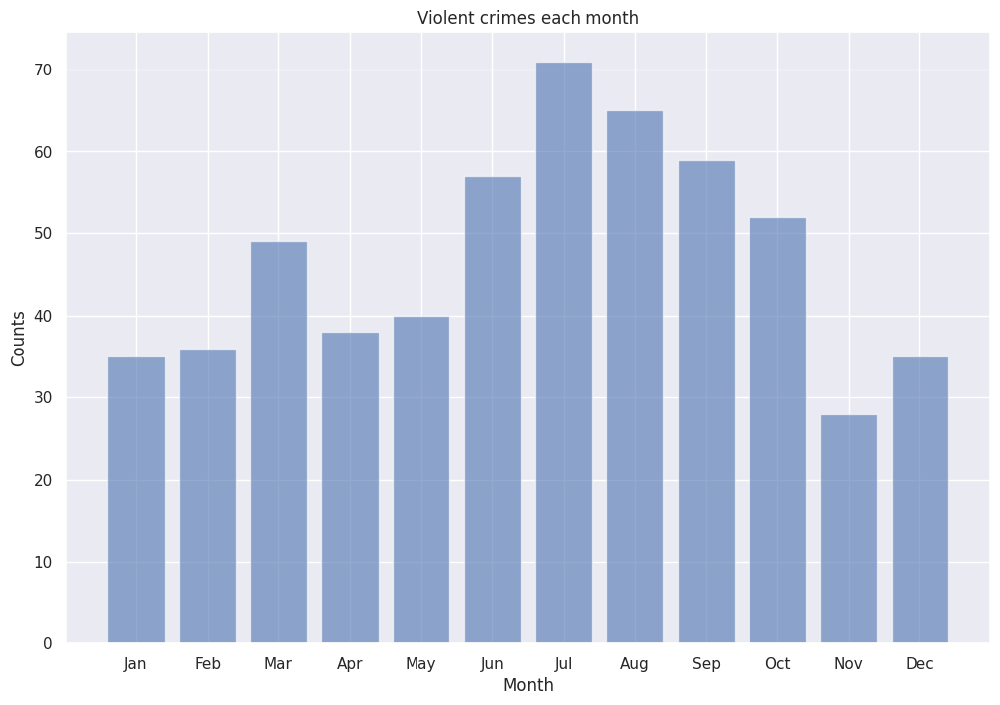

In [55]:

data_month = violentCrimeWithinPath.groupby(['YMonth']).size().reset_index(name='Counts')
data_month.YMonth.replace([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
                          ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'],
                          inplace = True)

bar_chart(data_month.YMonth, data_month.Counts, 'Violent crimes each month', 'Month', 'Counts')

/tmp/ipykernel_16172/2769806038.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



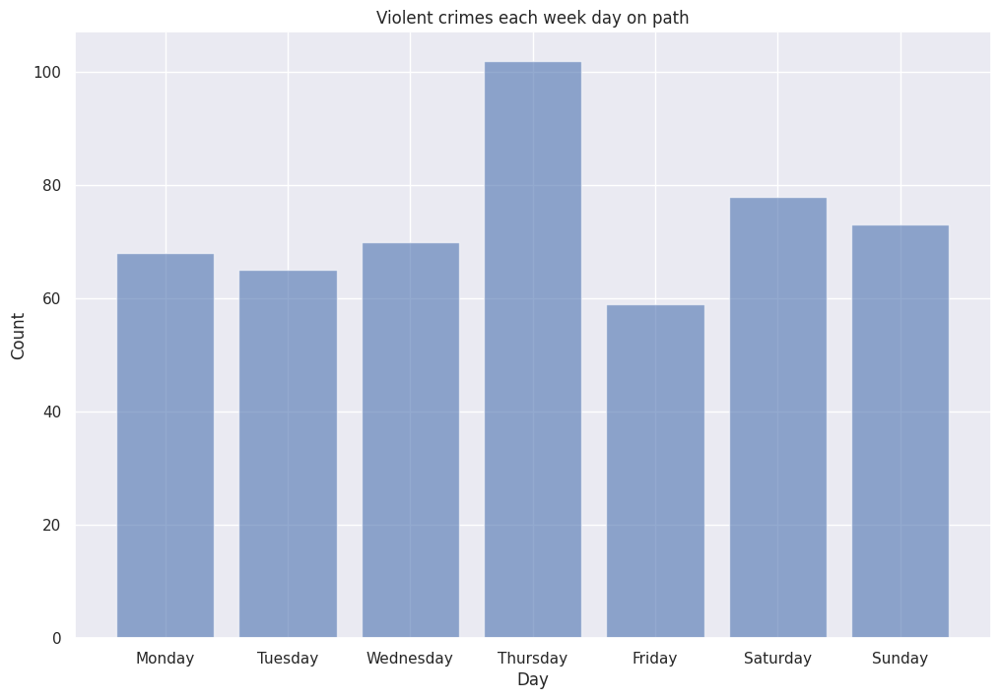

In [57]:
data_wday = violentCrimeWithinPath.groupby(['WDay']).size().reset_index(name='Counts')

bar_chart(data_wday.WDay, data_wday.Counts, 'Violent crimes each week day on path', 'Day', 'Count')

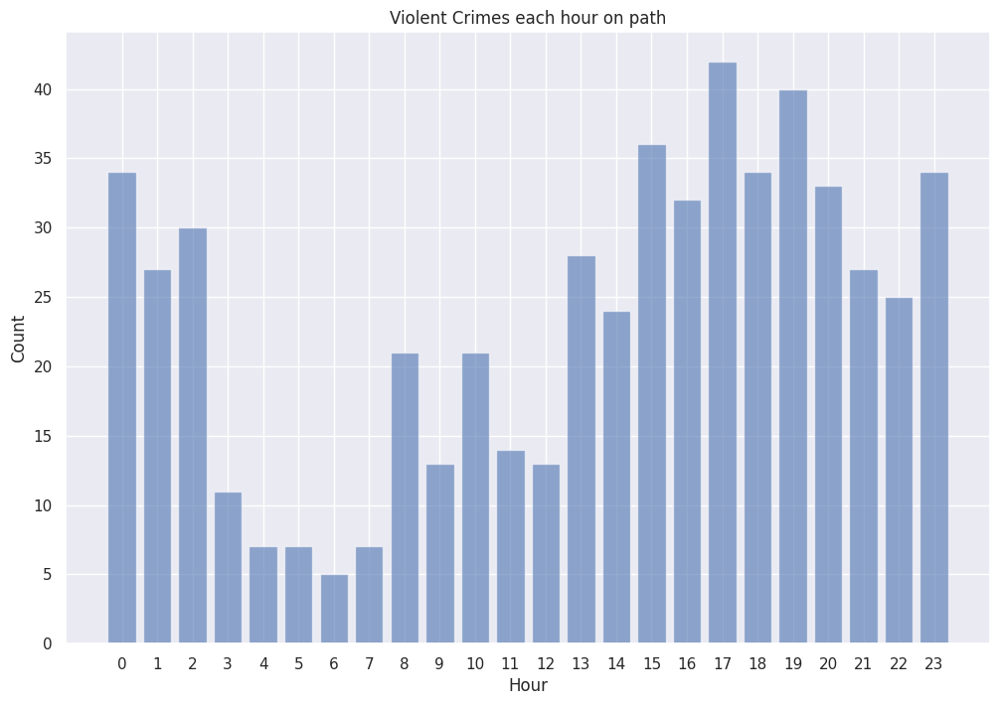

In [58]:
data_hour = violentCrimeWithinPath.groupby(['DHour']).size().reset_index(name='Counts')

bar_chart(data_hour.DHour, data_hour.Counts, 'Violent Crimes each hour on path', 'Hour', 'Count')